<h1><b>Loyalty Landscape: Segmenting Customers for Personalized Marketing</b></h1> 

Airline Loyalty EDA + Clustering

<h2><u>Use Case</u></h2>

<h3>Objective</h3>
<j>To identify distinct customer segments within the airline's loyalty program based on their flight booking behavior, loyalty engagement, and demographic characteristics. 

This segmentation will inform the development of targeted marketing strategies and personalized loyalty program offerings to maximize customer engagement and retention.

<h3>Challenge</h3>
<j>Airlines face intense competition, making it crucial to understand their customer base and tailor offerings accordingly. Traditional segmentation based on demographics often falls short, failing to capture the diverse needs and behaviors of loyalty program members.</j>

<h3>Business Benefits</h3>

1. Improved Marketing Strategies - Targeted marketing campaigns tailored to the preferences and behaviors of specific customer segments


<h3>Challenge</h3>
Airlines face intense competition, making it crucial to understand their customer base and tailor offerings accordingly. Traditional segmentation based on demographics often falls short, failing to capture the diverse needs and behaviors of loyalty program members.


<br> 
Targeted marketing strategies: Develop personalized campaigns and promotions tailored to each segment, increasing program engagement and effectiven>ss</br>.
Enhanced customer retention: Identify at-risk segments and implement proactive retention strategies to prevent churn.
Improved loyalty program design: Optimize program offerings and benefits based on segment preferences and nee

<h3>Business Benefits</h3>
    <br>1. Improved Marketing Strategies - Targeted marketing campaigns tailored to the preferences and behaviors of specific customer segments</br>
    <br>2. Enhanced Loyalty Programs - Optimization of loyalty program offerings based on the distinct needs of each segment </br>
    <br>3. 
Increased Customer Satisfacti </br>y    <br>4. .
Revenue Gro </br>nt.data

## Table of Contents<a name="TOC"></a>

1. [Data Preprocessing](#Section1)
<br>Data cleaning</br>

2. [Exploratory Data Analysis](#Section2)
<br>Analysis and data visualization</br>

3. [Model Generation](#Section3)
<br>Building Cluster Modelling using **K-Means Clustering**</br>

4. [Model Evaluation](#Section4)
<br>Evaluate the SVM modelling based on performance metrics</br>

**Importing libraries & dataset**

In [1]:
#import libraries

import warnings
warnings.filterwarnings('ignore')

# Data Manipulation
import pandas as pd
import numpy as np
import seaborn as sns
import statistics

# Data Visualization
import matplotlib.pyplot as plt
import plotly.express as px    #module for graphs
import seaborn as sns
sns.set()
sns.set_theme(style='whitegrid', palette='muted')

# Machine Learning
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [2]:
#import flight dataset
flight_df = pd.read_csv('Customer Flight Activity.csv')
print("Customer Flight Activity")

display(flight_df)

Customer Flight Activity


,Loyalty Number,Year,Month,Flights Booked,Flights with Companions,Total Flights,Distance,Points Accumulated,Points Redeemed,Dollar Cost Points Redeemed
0,100018,2017,1,3,0,3,1521,152.0,0,0
1,100102,2017,1,10,4,14,2030,203.0,0,0
2,100140,2017,1,6,0,6,1200,120.0,0,0
3,100214,2017,1,0,0,0,0,0.0,0,0
4,100272,2017,1,0,0,0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...
405619,999902,2018,12,0,0,0,0,0.0,0,0
405620,999911,2018,12,0,0,0,0,0.0,0,0
405621,999940,2018,12,3,0,3,1233,123.0,0,0
405622,999982,2018,12,0,0,0,0,0.0,0,0


In [3]:
#import loyalty dataset
loyalty_df = pd.read_csv('Customer Loyalty History.csv')
print("Customer Loyalty History")

display(loyalty_df)

Customer Loyalty History


,Loyalty Number,Country,Province,City,Postal Code,Gender,Education,Salary,Marital Status,Loyalty Card,CLV,Enrollment Type,Enrollment Year,Enrollment Month,Cancellation Year,Cancellation Month
0,480934,Canada,Ontario,Toronto,M2Z 4K1,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,NaN,NaN
1,549612,Canada,Alberta,Edmonton,T3G 6Y6,Male,College,NaN,Divorced,Star,3839.61,Standard,2016,3,NaN,NaN
2,429460,Canada,British Columbia,Vancouver,V6E 3D9,Male,College,NaN,Single,Star,3839.75,Standard,2014,7,2018.0,1.0
3,608370,Canada,Ontario,Toronto,P1W 1K4,Male,College,NaN,Single,Star,3839.75,Standard,2013,2,NaN,NaN
4,530508,Canada,Quebec,Hull,J8Y 3Z5,Male,Bachelor,103495.0,Married,Star,3842.79,Standard,2014,10,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16732,823768,Canada,British Columbia,Vancouver,V6E 3Z3,Female,College,NaN,Married,Star,61850.19,Standard,2012,12,NaN,NaN
16733,680886,Canada,Saskatchewan,Regina,S1J 3C5,Female,Bachelor,89210.0,Married,Star,67907.27,Standard,2014,9,NaN,NaN
16734,776187,Canada,British Columbia,Vancouver,V5R 1W3,Male,College,NaN,Single,Star,74228.52,Standard,2014,3,NaN,NaN
16735,906428,Canada,Yukon,Whitehorse,Y2K 6R0,Male,Bachelor,-57297.0,Married,Star,10018.66,2018 Promotion,2018,4,NaN,NaN


## Data Understanding

In [4]:
flight_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 405624 entries, 0 to 405623
Data columns (total 10 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Loyalty Number               405624 non-null  int64  
 1   Year                         405624 non-null  int64  
 2   Month                        405624 non-null  int64  
 3   Flights Booked               405624 non-null  int64  
 4   Flights with Companions      405624 non-null  int64  
 5   Total Flights                405624 non-null  int64  
 6   Distance                     405624 non-null  int64  
 7   Points Accumulated           405624 non-null  float64
 8   Points Redeemed              405624 non-null  int64  
 9   Dollar Cost Points Redeemed  405624 non-null  int64  
dtypes: float64(1), int64(9)
memory usage: 30.9 MB


In [5]:
loyalty_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16737 entries, 0 to 16736
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Loyalty Number      16737 non-null  int64  
 1   Country             16737 non-null  object 
 2   Province            16737 non-null  object 
 3   City                16737 non-null  object 
 4   Postal Code         16737 non-null  object 
 5   Gender              16737 non-null  object 
 6   Education           16737 non-null  object 
 7   Salary              12499 non-null  float64
 8   Marital Status      16737 non-null  object 
 9   Loyalty Card        16737 non-null  object 
 10  CLV                 16737 non-null  float64
 11  Enrollment Type     16737 non-null  object 
 12  Enrollment Year     16737 non-null  int64  
 13  Enrollment Month    16737 non-null  int64  
 14  Cancellation Year   2067 non-null   float64
 15  Cancellation Month  2067 non-null   float64
dtypes: f

1. We have data for period 2012 - 2018 of loyalty card holders2. 
And two years 2017-2018 of flights data3. 
The 2018 campaign took part during 3 months fro**m Februa**ry t**o Apr**il that yea4. r
Those who participated in the promotion, booked flights only in 2017 and 2018 years

From the above information, we can infer that there are 16737 unique loyalty customers.
Since the aim of this code is to collect data on them, let us cluster the data based on the customers only.

In [ ]:
# Add Datetime column from Year + Month columns, set indices (Loyalty Number, Date)
flights = flights.set_index([
    'Loyalty Number', 
    pd.to_datetime(flights[['Year', 'Month']].assign(DAY=1)).rename('Date')
])

loyalty = pd.concat([
    loyalty,
    pd.to_datetime(dict(year=loyalty['Enrollment Year'], 
                        month=loyalty['Enrollment Month'], day=1)).rename('Enrollment Date'),
    pd.to_datetime(dict(year=loyalty['Cancellation Year'], 
                        month=loyalty['Cancellation Month'], day=1)).rename('Cancellation Date')
], axis=1).set_index('Loyalty Number')

## Data Transformation

Join the two dataframes using the column 'Loyalty Number'

In [9]:
# Merging both the Customer Loyalty and Customer Flights Dataset based on Loyalty Number column.
airline_df = pd.merge(loyalty_df, flight_df, on='Loyalty Number', how='inner')

display(airline_df)

,Loyalty Number,Country,Province,City,Postal Code,Gender,Education,Salary,Marital Status,Loyalty Card,...,Cancellation Month,Year,Month,Flights Booked,Flights with Companions,Total Flights,Distance,Points Accumulated,Points Redeemed,Dollar Cost Points Redeemed
0,480934,Canada,Ontario,Toronto,M2Z 4K1,Female,Bachelor,83236.0,Married,Star,...,NaN,2017,1,0,0,0,0,0.0,0,0
1,480934,Canada,Ontario,Toronto,M2Z 4K1,Female,Bachelor,83236.0,Married,Star,...,NaN,2017,2,3,0,3,2823,282.0,0,0
2,480934,Canada,Ontario,Toronto,M2Z 4K1,Female,Bachelor,83236.0,Married,Star,...,NaN,2017,3,0,0,0,0,0.0,0,0
3,480934,Canada,Ontario,Toronto,M2Z 4K1,Female,Bachelor,83236.0,Married,Star,...,NaN,2017,4,0,0,0,0,0.0,0,0
4,480934,Canada,Ontario,Toronto,M2Z 4K1,Female,Bachelor,83236.0,Married,Star,...,NaN,2018,10,6,2,8,3352,335.0,465,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
405619,652627,Canada,Manitoba,Winnipeg,R2C 0M5,Female,Bachelor,75049.0,Married,Star,...,8.0,2018,8,0,0,0,0,0.0,0,0
405620,652627,Canada,Manitoba,Winnipeg,R2C 0M5,Female,Bachelor,75049.0,Married,Star,...,8.0,2018,9,0,0,0,0,0.0,0,0
405621,652627,Canada,Manitoba,Winnipeg,R2C 0M5,Female,Bachelor,75049.0,Married,Star,...,8.0,2018,10,0,0,0,0,0.0,0,0
405622,652627,Canada,Manitoba,Winnipeg,R2C 0M5,Female,Bachelor,75049.0,Married,Star,...,8.0,2018,11,0,0,0,0,0.0,0,0


In [10]:
# Create summry data Info
# Find out unique value, number of missing values & datatype of each column (Numerical and Non-Numerical)

list = []

for col in airline_df.columns:
    list.append([col, airline_df[col].dtype, airline_df[col].isna().sum(), 
                 100*airline_df[col].isna().sum()/len(airline_df[col]), 
                 airline_df[col].unique()[0:3], airline_df[col].nunique()])
df_summary = pd.DataFrame(data=list, columns=['Feature', 'Dtype', 'NaN','%NaN','Unique', 'Total Unique'])
df_summary

,Feature,Dtype,NaN,%NaN,Unique,Total Unique
0,Loyalty Number,int64,0,0.000000,"[480934, 549612, 429460]",16737
1,Country,object,0,0.000000,[Canada],1
2,Province,object,0,0.000000,"[Ontario, Alberta, British Columbia]",11
3,City,object,0,0.000000,"[Toronto, Edmonton, Vancouver]",29
4,Postal Code,object,0,0.000000,"[M2Z 4K1, T3G 6Y6, V6E 3D9]",55
5,Gender,object,0,0.000000,"[Female, Male]",2
6,Education,object,0,0.000000,"[Bachelor, College, Master]",5
7,Salary,float64,102672,25.312112,"[83236.0, nan, 103495.0]",5890
8,Marital Status,object,0,0.000000,"[Married, Divorced, Single]",3
9,Loyalty Card,object,0,0.000000,"[Star, Aurora, Nova]",3


Let's drop the 'Country' column since it is redundant (only has 1 unique value = Canada). Plus, we could also drop the 'Province' column as we will be working with the more varied 'City' column for better clustering.

We can drop the 'Dollar Cost Points Redeemed' column too as we're more interested in the loyalty points themselves rather than their dollar equivalent.

### Remove Irrelevant Columns 

In [11]:
# Remove columns 'Country', 'Province' & 'Dollar Cost Points Redeemed'
final_df = airline_df.drop(['Country',
         'Province',
         'Postal Code',
         'Dollar Cost Points Redeemed', 
         'Year', 
         'Month', 
         'Cancellation Year', 
         'Cancellation Month'
        ], axis=1)

# Display results
final_df

,Loyalty Number,City,Gender,Education,Salary,Marital Status,Loyalty Card,CLV,Enrollment Type,Enrollment Year,Enrollment Month,Flights Booked,Flights with Companions,Total Flights,Distance,Points Accumulated,Points Redeemed
0,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,0,0,0,0,0.0,0
1,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,3,0,3,2823,282.0,0
2,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,0,0,0,0,0.0,0
3,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,0,0,0,0,0.0,0
4,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,6,2,8,3352,335.0,465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
405619,652627,Winnipeg,Female,Bachelor,75049.0,Married,Star,83325.38,Standard,2015,12,0,0,0,0,0.0,0
405620,652627,Winnipeg,Female,Bachelor,75049.0,Married,Star,83325.38,Standard,2015,12,0,0,0,0,0.0,0
405621,652627,Winnipeg,Female,Bachelor,75049.0,Married,Star,83325.38,Standard,2015,12,0,0,0,0,0.0,0
405622,652627,Winnipeg,Female,Bachelor,75049.0,Married,Star,83325.38,Standard,2015,12,0,0,0,0,0.0,0


## 1. Data Preprocessing<a name="Section1"></a>

We need to clean our data first before proceeding with our ML tasks for this project.

Let's proceed with checking the crucial info in our data to facilitate the data preprocessing phase.

### 1.1 Missing Values Check

<Axes: >

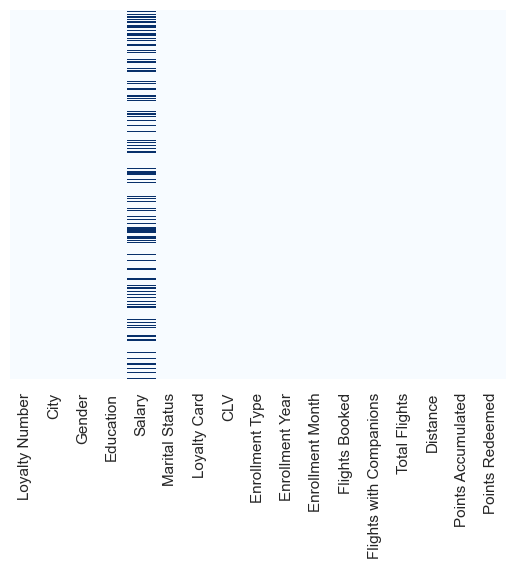

In [12]:
# Let's see if we have any missing data.
sns.heatmap(final_df.isnull(), yticklabels = False, cbar = False, cmap="Blues")

It is obvious that there are missing values in `Salary` based on their % of null values

Let's first observe how the data are distributed.

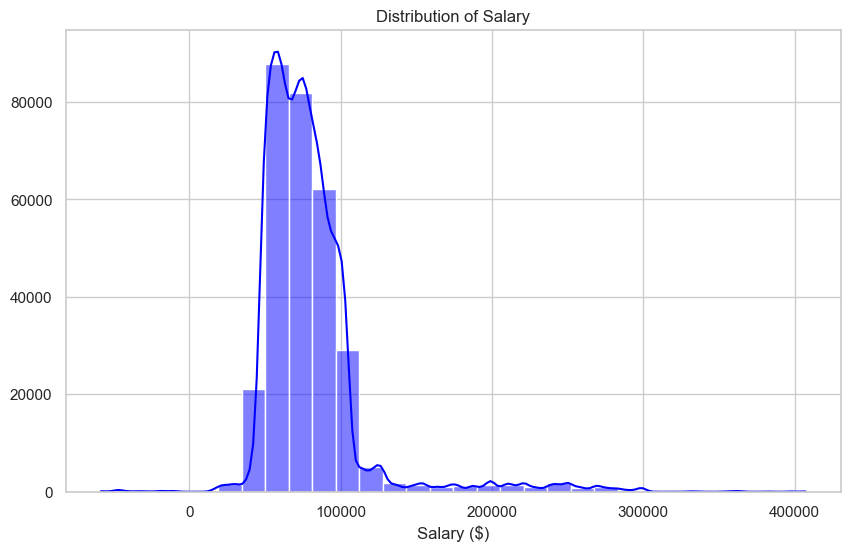

In [13]:
# Histogram for Salary
plt.figure(figsize=(10, 6))
sns.histplot(final_df['Salary'], bins=30, kde=True, color='blue')
plt.title('Distribution of Salary')
plt.xlabel('Salary ($)')
plt.ylabel('')
plt.show()

We observe that the data are Gaussian (normal) with a slight positive skew, implying that the median value will be of use to us here.

### 1.2 Duplications Check

In [14]:
new_final_deduped = final_df.drop_duplicates()

print("Number of records after removing duplicates : {}".format(new_final_deduped.shape[0]))
print("Number of records in original dataset : {}".format(final_df.shape[0]))

new_final_deduped

Number of records after removing duplicates : 224338
Number of records in original dataset : 405624


,Loyalty Number,City,Gender,Education,Salary,Marital Status,Loyalty Card,CLV,Enrollment Type,Enrollment Year,Enrollment Month,Flights Booked,Flights with Companions,Total Flights,Distance,Points Accumulated,Points Redeemed
0,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,0,0,0,0,0.0,0
1,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,3,0,3,2823,282.0,0
4,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,6,2,8,3352,335.0,465
5,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,13,4,17,3757,375.0,0
6,480934,Toronto,Female,Bachelor,83236.0,Married,Star,3839.14,Standard,2016,2,12,0,12,1320,132.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
405594,906428,Whitehorse,Male,Bachelor,-57297.0,Married,Star,10018.66,2018 Promotion,2018,4,16,0,16,3392,339.0,0
405596,906428,Whitehorse,Male,Bachelor,-57297.0,Married,Star,10018.66,2018 Promotion,2018,4,8,0,8,2120,212.0,0
405598,906428,Whitehorse,Male,Bachelor,-57297.0,Married,Star,10018.66,2018 Promotion,2018,4,3,3,6,822,82.0,0
405599,906428,Whitehorse,Male,Bachelor,-57297.0,Married,Star,10018.66,2018 Promotion,2018,4,13,0,13,2912,291.0,0


A total of 1,864 duplicate records have been removed. Thus, we're going to use new_final_deduped moving forward.

In [17]:
# Save the merged + cleaned dataset as a CSV file
final_df.to_csv('Merged Customer Loyalty Flights.csv', index=False)

## 2. Data Visualization & Analysis<a name="Section2"></a>

## Table of Contents<a name="TOC"></a>

2.1 [Check Correlations](#Section7)

2.2 [Demographic Analysis](#Section8)

2.3 [Customer Flight Activity](#Section9)

2.4 [Loyalty Program Insights](#Section10)

2.5 [Customer Segment Distribution](#Section11)

In [19]:
final_encoded=pd.get_dummies(new_final_deduped, columns=['Gender', 'Loyalty Card'])
final_encoded

,Loyalty Number,City,Education,Salary,Marital Status,CLV,Enrollment Type,Enrollment Year,Enrollment Month,Flights Booked,Flights with Companions,Total Flights,Distance,Points Accumulated,Points Redeemed,Gender_Female,Gender_Male,Loyalty Card_Aurora,Loyalty Card_Nova,Loyalty Card_Star
0,480934,Toronto,Bachelor,83236.0,Married,3839.14,Standard,2016,2,0,0,0,0,0.0,0,True,False,False,False,True
1,480934,Toronto,Bachelor,83236.0,Married,3839.14,Standard,2016,2,3,0,3,2823,282.0,0,True,False,False,False,True
4,480934,Toronto,Bachelor,83236.0,Married,3839.14,Standard,2016,2,6,2,8,3352,335.0,465,True,False,False,False,True
5,480934,Toronto,Bachelor,83236.0,Married,3839.14,Standard,2016,2,13,4,17,3757,375.0,0,True,False,False,False,True
6,480934,Toronto,Bachelor,83236.0,Married,3839.14,Standard,2016,2,12,0,12,1320,132.0,0,True,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
405594,906428,Whitehorse,Bachelor,-57297.0,Married,10018.66,2018 Promotion,2018,4,16,0,16,3392,339.0,0,False,True,False,False,True
405596,906428,Whitehorse,Bachelor,-57297.0,Married,10018.66,2018 Promotion,2018,4,8,0,8,2120,212.0,0,False,True,False,False,True
405598,906428,Whitehorse,Bachelor,-57297.0,Married,10018.66,2018 Promotion,2018,4,3,3,6,822,82.0,0,False,True,False,False,True
405599,906428,Whitehorse,Bachelor,-57297.0,Married,10018.66,2018 Promotion,2018,4,13,0,13,2912,291.0,0,False,True,False,False,True


## Multivariate Analysis

### 2.1 Check Correlations

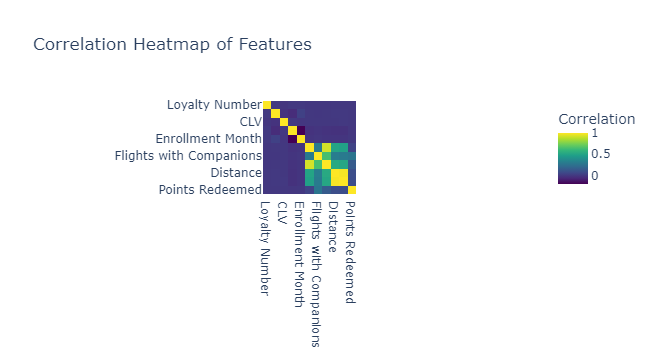

In [20]:
# Create a correlation matrix
num = new_final_deduped.select_dtypes(include=['int64', 'float64', 'boolean']).columns

correlation_matrix = new_final_deduped[num].corr()

fig = px.imshow(correlation_matrix,
                labels=dict(color="Correlation"),
                x=correlation_matrix.index,
                y=correlation_matrix.columns,
                color_continuous_scale='Viridis',
                title='Correlation Heatmap of Features')

# Show the plot
fig.show()

**According to the heatmap, there are some observations:**
<br>1.
Those members who have cancelled their membership have a negative trend with the number of flights and points accumulated/redeemed.<br>2.
A higher value of Enrollment Year and a lower value of Cancellation Year correlates to a lower value of flights and points accumulated/redeemed.

**Some features appear to be above 2 points due to their shorter record tenure**

<br>1.
There is a strong positive trending association between the number of points earned and the number of flights booked.

<br>2.The CLV (Customer Lifetime Value) and the status of the loyalty card have a small association. Star is slightly trending downward, and Aurora is somewhat trending upward.

### 2.2 Customer Demographic Analysis

**What are the primary cities from which customers are enrolled in the loyalty program?**

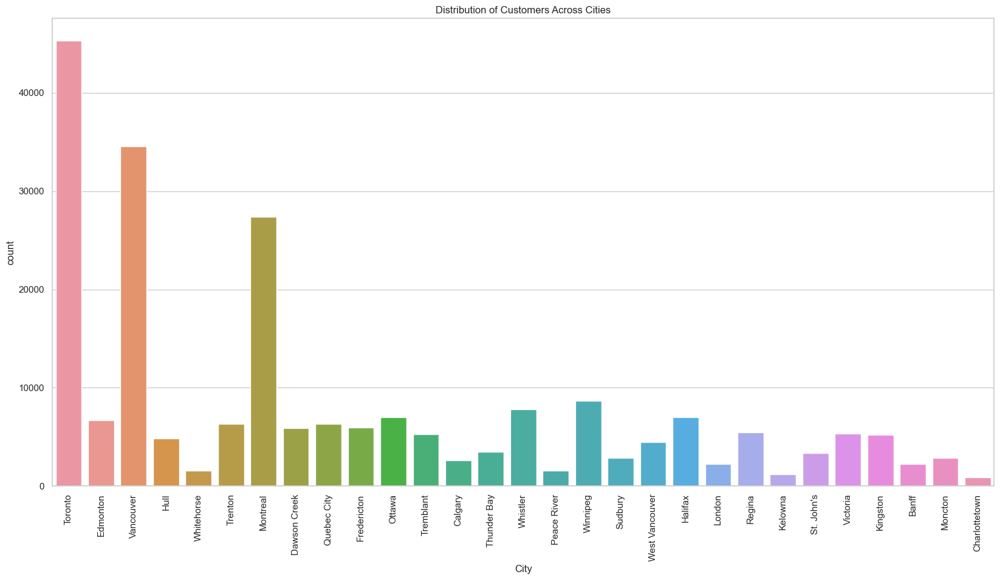

In [21]:
# City Distribution
plt.figure(figsize=(20, 10))
sns.countplot(x='City', data=new_final_deduped)
plt.title('Distribution of Customers Across Cities')
plt.xticks(rotation=90)
plt.show()

**Salary Trends Over Enrollment Years by Education Level**

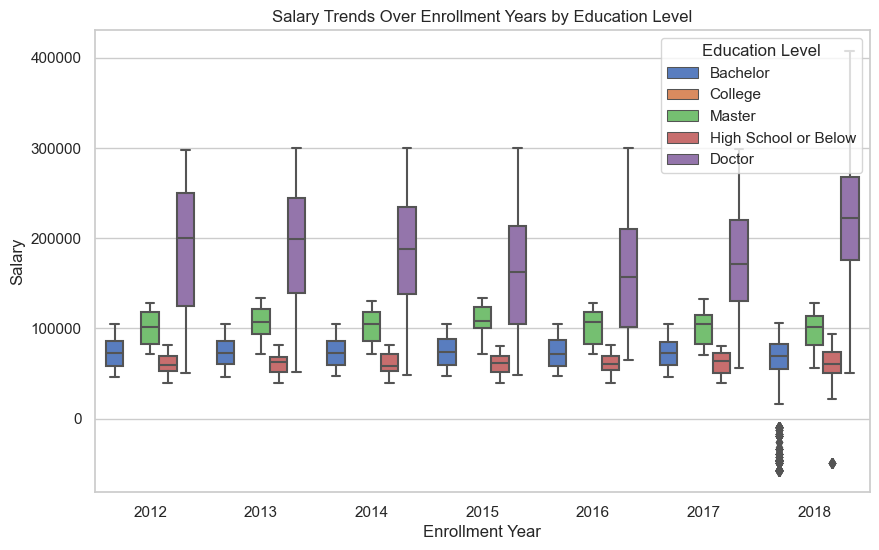

In [22]:
# Education levels and salary trends over enrollment years
plt.figure(figsize=(10, 6))
sns.boxplot(data=new_final_deduped, x='Enrollment Year', y='Salary', hue='Education')
plt.title('Salary Trends Over Enrollment Years by Education Level')
plt.xlabel('Enrollment Year')
plt.ylabel('Salary')
plt.legend(title='Education Level')
plt.show()

**Relationship between Demographics and Booking/Loyalty**
<br>Are there any relationships between customer demographics (e.g., age, gender, marital status) and their booking behaviour or loyalty program engagement? (Scatter plots/Correlation matrix)

### 2.2 Customer Flight Activity

How does the distribution of the number of flights booked vary across different months and years?

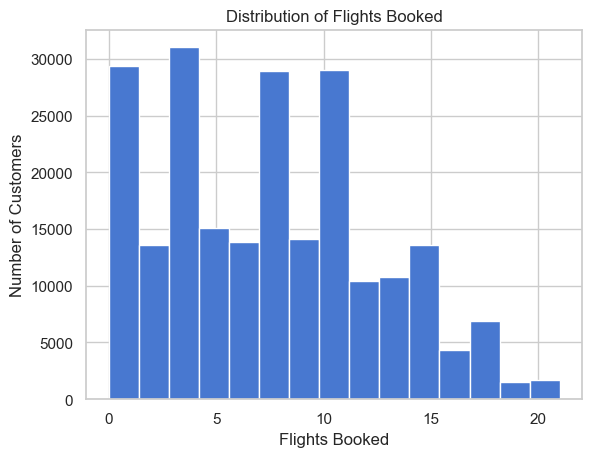

In [24]:
# Plot the distribution of Flights Booked
plt.hist(new_final_deduped["Flights Booked"], bins=15)
plt.xlabel("Flights Booked")
plt.ylabel("Number of Customers")
plt.title("Distribution of Flights Booked")
plt.show()

**How many customers book flights with companions, and how does this behavior vary across different loyalty tiers?**

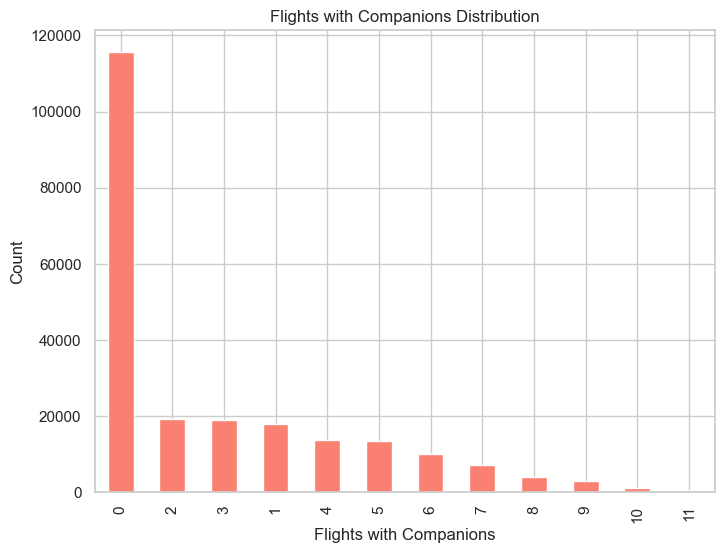

In [28]:
# Flights with companions distribution
plt.figure(figsize=(8, 6))
new_final_deduped['Flights with Companions'].value_counts().plot(kind='bar', color='salmon')
plt.title('Flights with Companions Distribution')
plt.xlabel('Flights with Companions')
plt.ylabel('Count')
plt.show()

**Are there any seasonal trends or patterns in terms of flights booked, distance traveled, or points accumulated?**

**Can we identify high-value customers who frequently book flights or redeem points?**

### 2.3 Loyalty Program Insights

What is the distribution of customers across different loyalty card levels (Star, Nova, Aurora)?

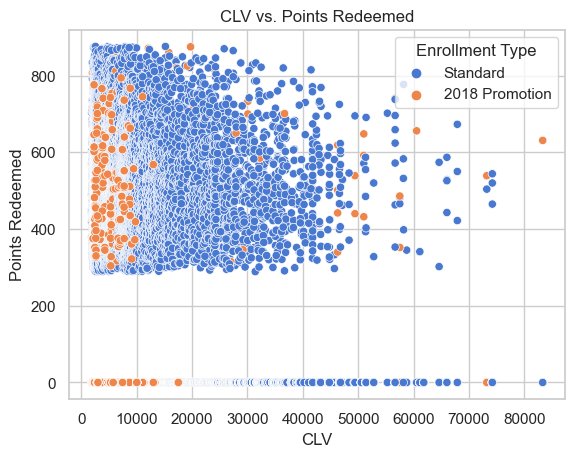

In [25]:
# Scatter plot to visualize the relationship between CLV and points redemption
sns.scatterplot(x='CLV', y='Points Redeemed', hue='Enrollment Type', data=new_final_deduped)
plt.title('CLV vs. Points Redeemed')
plt.show()

We can observe that

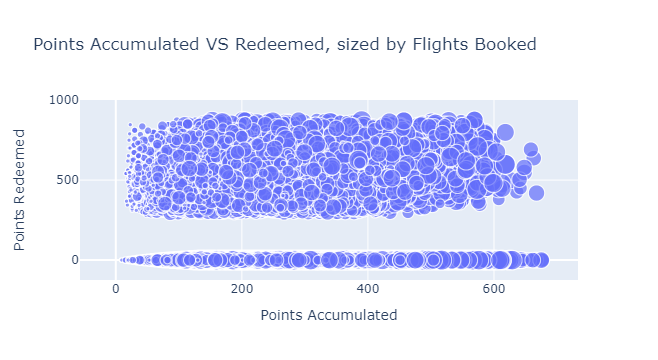

In [26]:
fig0 = px.scatter(new_final_deduped, x='Points Accumulated', y='Points Redeemed',
                         size='Flights Booked', hover_data=['Loyalty Number'],
                         title='Points Accumulated VS Redeemed, sized by Flights Booked')
fig0.show()

**We can infer from the above graph that the more points are accumulated, the more flights are booked. Additionally, despite what logic dictates, it is not clear that more accumulation results to higher redemption of points.**


In [ ]:
# Patterns in enrollment and cancellation over the years
enrollment_trends = new_final_deduped.groupby('Enrollment Year')['Loyalty Number'].count()
cancellation_trends = new_final_deduped.groupby('Cancellation Year')['Loyalty Number'].count()

display(new_final_deduped)
display(new_final_deduped)

In [ ]:
# Time series line chart for enrollment and cancellation trends
sns.lineplot(x='Year', y='Total Flights', hue='Enrollment Type', data=airline_df)
plt.title('Enrollment and Cancellation Trends Over the Years')
plt.show()

**Points Accumulation and Redemption**
<br>How do customers accumulate and redeem loyalty points? Are there any distinct patterns or trends within different segments?

In [ ]:
import plotly.express as px

# Scatter plot for points accumulation and redemption
scatter_fig = px.scatter(df, x='Points Accumulated', y='Points Redeemed', color='Segment',
                         hover_data=['Total Flights', 'CLV'],
                         title='Points Accumulation and Redemption by Customer Segment')
scatter_fig.update_layout(xaxis_title='Points Accumulated', yaxis_title='Points Redeemed', showlegend=True)
scatter_fig.show()

# Box plot for points accumulation and redemption by segment
box_fig = px.box(df, x='Segment', y='Points Accumulated', points="all",
                  title='Distribution of Points Accumulated by Customer Segment')
box_fig.update_layout(xaxis_title='Segment', yaxis_title='Points Accumulated')
box_fig.show()

# Box plot for points redemption by segment
box_fig = px.box(df, x='Segment', y='Points Redeemed', points="all",
                  title='Distribution of Points Redeemed by Customer Segment')
box_fig.update_layout(xaxis_title='Segment', yaxis_title='Points Redeemed')
box_fig.show()


In [ ]:
fig4 = px.scatter(final, y = 'Points Accumulated', x = 'Flights Booked',title = 'Points Accumulated per Flight')
fig4.show()

### 2.5 Customer Segment Distribution

In [ ]:
plt.figure(figsize=(12, 6))
sns.histplot(x='CLV', data=airline_df, bins=20, kde=True)
plt.title('Distribution of Customer Lifetime Value (CLV)')
plt.show()

<h2>Feature Engineering</h2>

**Are there opportunities for creating new features that could enhance the segmentation process?**


## Handling Outliers

In [ ]:
plt.figure(figsize=(20,5))
features = ['Salary', 'CLV', 'Points Accumulated']
for i in range(0, len(features)):
    plt.subplot(1, 7, i+1)
    sns.boxplot(y=airline_df[features[i]], color='skyblue')
    plt.tight_layout()

<h2>RFM Analysis</h2>

RFM analysis allows you to segment customers by the frequency and value of purchases and identify those customers who spend the most money.
**
Recenc(R)** y — how long it’s been since a customer bought something from us.**

Frequ (F)**ency — how often a customer buys from u**s.

Mo (M)** value — the total value of purchases a customer has made.

RFM analysis is a powerful method for segmenting customers based on their transaction history, focusing on three key metrics:

In [ ]:
# Calculate Recency
# Assuming today's date is 2024-02-25
df['Enrollment Date'] = pd.to_datetime(df['Enrollment Year'].astype(str) + '-' + df['Enrollment Month'].astype(str))
today = pd.to_datetime('2024-02-25')
df['Recency'] = (today - df['Enrollment Date']).dt.days

In [ ]:
# Define Frequency and Monetary
frequency_cols = ['Flights Booked', 'Total Flights', 'Points Accumulated']
monetary_cols = ['CLV', 'Salary', 'Points Redeemed']

In [ ]:
# Combine Frequency and Monetary into a single score
df['Frequency'] = df[frequency_cols].sum(axis=1)
df['Monetary'] = df[monetary_cols].sum(axis=1)

In [ ]:
# Select RFM features
rfm_df = df[['Recency', 'Frequency', 'Monetary']]

In [ ]:
# Standardize the data
scaler = StandardScaler()
rfm_scaled = scaler.fit_transform(rfm_df)

In [ ]:
# Visualize RFM scores for segmentation
fig = px.scatter_3d(df, x='Recency', y='Frequency', z='Monetary', color='Cluster', title='RFM Segmentation')
fig.show()

## 3. Model Generation<a name="Section3"></a>

K-Means clustering algorithm is an unsupervised machine learning algorithm that uses multiple iterations to segment the unlabeled data points into K different clusters in a way such that each data point belongs to only a single group that has similar properties.

<img src="https://static.javatpoint.com/tutorial/machine-learning/images/k-means-clustering-algorithm-in-machine-learning.png">

**Why use K-Means Algorithm for Customer Segmentation?**
K-Means algorithm is chosen for customer segmentation in this project due to its simplicity, efficiency, and effectiveness in identifying distinct clusters within the dataset.

It offers a practical and efficient approach to customer segmentation, providing valuable insights into customer behavior and preferences for enhanced marketing and loyalty program management.

Before we do the modeling, we have to determine the number of clusters. For determining the optimal number of clusters, I check the inertia

### Elbow Plot

In [ ]:
inertia = []

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(data_std)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(12, 8))
sns.lineplot(x=range(1, 11), y=inertia, color='#000087', linewidth = 4)
sns.scatterplot(x=range(1, 11), y=inertia, s=300, color='#800000',  linestyle='--')
plt.xticks(range(1,11))
plt.xlabel("Number of Clusters")
plt.ylabel("Inertia")
plt.show()

## K-Means Clustering

<h2>Conclusion</h2>

In [ ]:
#Overview of Clustering Results
display(final_cluster.groupby('CLUSTER').agg({'LAST_TO_END':'median', 'FLIGHT_COUNT':'median', 'AVG_INTERVAL':'median', 'FFP_TO_LAST': 'mean','avg_discount': 'mean'}).round(2))